In [1]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import IPython.display as ipd
from pathlib import Path
import numpy as np

In [49]:
#example = r'/home/awa5114/code/awa5114/ai_dj/ai_dj/data/Two Scoops.webm'
remix = '/Users/willemsickinghe/Downloads/I Still Love You.mp3'
y, sr = librosa.load(remix)

/Users/willemsickinghe/.pyenv/versions/3.8.6/envs/lewagon/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [34]:
onsets = librosa.onset.onset_detect(y, sr)
times = librosa.frames_to_time(onsets, sr)

In [35]:
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
times = librosa.frames_to_time(beats, sr)
y_beats = librosa.clicks(frames=beats, sr=sr, length=len(y))
ipd.display(ipd.Audio(y+y_beats, rate=sr))

In [5]:
pulse = librosa.beat.plp(y=y, sr=sr)
beats_plp = np.flatnonzero(librosa.util.localmax(pulse))
times = librosa.frames_to_time(beats, sr)
y_beats_plp = librosa.clicks(frames=beats, sr=sr, length=len(y))
ipd.display(ipd.Audio(y+y_beats_plp, rate=sr))

In [48]:
data_dir = Path('/Users/willemsickinghe/Downloads/I Still Love You.mp3')
audio_files = list(data_dir.glob('*.webm'))

In [39]:
for audio_file in audio_files:
    y, sr = librosa.load(audio_file)
    tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
    y_beats = librosa.clicks(frames=beats, sr=sr, length=len(y))
    times = librosa.frames_to_time(beats, sr)
    ipd.display(ipd.Audio(y+y_beats, rate=sr))

In [40]:
for audio_file in audio_files:
    y, sr = librosa.load(audio_file)
    pulse = librosa.beat.plp(y=y, sr=sr)
    beats_plp = np.flatnonzero(librosa.util.localmax(pulse))
    times = librosa.frames_to_time(beats, sr)
    y_beats_plp = librosa.clicks(frames=beats, sr=sr, length=len(y))
    ipd.display(ipd.Audio(y+y_beats_plp, rate=sr))

In [50]:
y, sr = librosa.load(remix)
cent = librosa.feature.spectral_centroid(y=y, sr=sr)

/Users/willemsickinghe/.pyenv/versions/3.8.6/envs/lewagon/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


In [51]:
S, phase = librosa.magphase(librosa.stft(y=y))
librosa.feature.spectral_centroid(S=S)

array([[2383.46210935, 2916.47932664, 3186.00962424, ...,    0.        ,
           0.        ,    0.        ]])

In [52]:
freqs, times, D = librosa.reassigned_spectrogram(y, fill_nan=True)
librosa.feature.spectral_centroid(S=np.abs(D), freq=freqs)

/Users/willemsickinghe/.pyenv/versions/3.8.6/envs/lewagon/lib/python3.8/site-packages/librosa/core/spectrum.py:608: RuntimeWarning: invalid value encountered in true_divide
  correction = -np.imag(S_dh / S_h)
/Users/willemsickinghe/.pyenv/versions/3.8.6/envs/lewagon/lib/python3.8/site-packages/librosa/core/spectrum.py:780: RuntimeWarning: invalid value encountered in true_divide
  correction = np.real(S_th / S_h)


array([[2382.69197689, 2915.96107308, 3185.61326079, ...,    0.        ,
           0.        ,    0.        ]])

AttributeError: 'function' object has no attribute 'y_axislim'

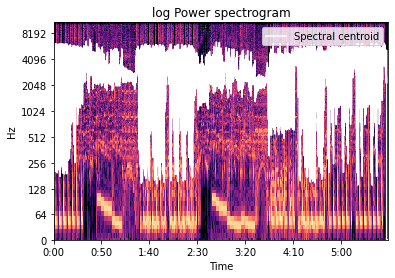

In [126]:
import matplotlib.pyplot as plt
times = librosa.times_like(cent)
fig, ax = plt.subplots()
librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax)
ax.plot(times, cent.T, label='Spectral centroid', color='w')
ax.legend(loc='upper right')
ax.set(title='log Power spectrogram')
ax.set.y_axislim(120, 3000)
#y_axis = np.arange(120, 3000)

No handles with labels found to put in legend.


[Text(0.5, 1.0, 'log Power spectrogram')]

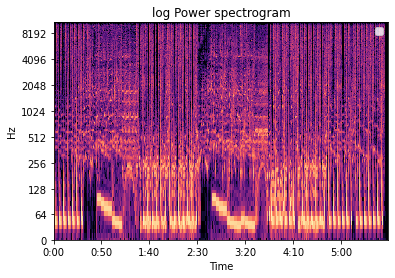

In [131]:
import matplotlib.pyplot as plt
times = librosa.times_like(cent)
fig, ax = plt.subplots()
librosa.display.specshow(librosa.amplitude_to_db(S, ref=np.max),
                         y_axis='log', x_axis='time', ax=ax)
#ax.plot(times, cent.T, label='Spectral centroid', color='w')
ax.legend(loc='upper right')
ax.set(title='log Power spectrogram')
#ax.set_ylim(120, 3000)
#y_axis = np.arange(120, 3000)

In [ ]:
# plot specific time moments of spectral centroid

In [ ]:
if Hz = 128 > 4036 


# if statement saying 

In [87]:
import matplotlib.pyplot as plt
from scipy.io import wavfile as wav

rate, data = wav.read('/Users/willemsickinghe/Downloads/I Still Love You.mp3')

%matplotlib inline
plt.plot(data)
plt.show()

ValueError: File format b'ID3\x03'... not understood.

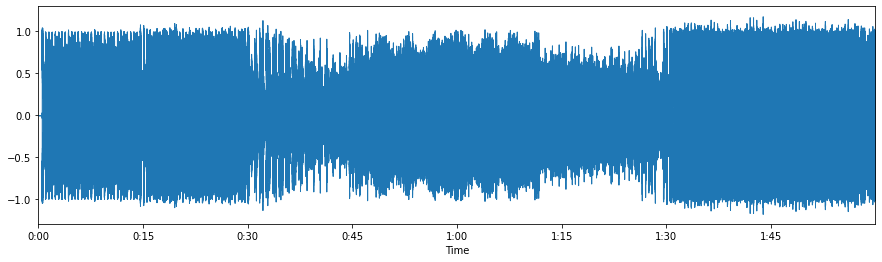

In [100]:
filename1 = '/Users/willemsickinghe/Downloads/I Still Love You.mp3'
plt.figure(figsize=(15,4))
data1,sample_rate1 = librosa.load(filename1, 
                                  sr=22050, 
                                  mono=True, 
                                  offset=0.0, 
                                  duration=120)
librosa.display.waveplot(data1,sr=sample_rate1, max_points=2000.0, x_axis='time', offset=0.0, max_sr=1000)

In [108]:
print(data1)
print(len(data1))

[ 0.          0.          0.         ... -0.4431319  -0.3975661
 -0.51800317]
2646000


In [113]:
import numpy as np

def spectral_centroid(x, samplerate=44100):
    magnitudes = np.abs(np.fft.rfft(x)) # magnitudes of positive frequencies
    length = len(x)
    freqs = np.abs(np.fft.fftfreq(length, 1.0/samplerate)[:length//2+1]) # positive frequencies
    return np.sum(magnitudes*freqs) / np.sum(magnitudes) # return weighted mean
spectral_centroid

<function __main__.spectral_centroid(x, samplerate=44100)>

In [112]:
def spectral_flatness(x): 
    X_f = fft(x) 
    N = len(X_f) 
    magnitude = abs(X_f[:N/2]) 
    sf = geom_mean(magnitude) / aritm_mean(magnitude) 
    return sf
spectral_flatness

<function __main__.spectral_flatness(x)>